In [1]:
from azure.storage.file import FileService
import json
import os
from PIL import Image, ImageDraw
import pandas as pd
import re
import numpy as np
from eMammal_helpers import draw_bboxes

In [2]:
# print all outputs in a cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# auto reload external Python modules
%load_ext autoreload
%autoreload 2

# Check the annotations from iMerit

Download the annotation file from File Share to temp folder on local - **Do once**

In [3]:
key = os.environ["AZ_STORAGE_KEY"]
file_service = FileService(account_name='ai4edevshare', account_key=key)

In [9]:
annotation_path = '/home/yasiyu/yasiyu_temp/eMammal_annotations/microsoft_batch6_29Sept2018.json'

In [10]:
file_service.get_file_to_path('ai4edevfs', 'annotations/incoming_annotations', os.path.basename(annotation_path), annotation_path)

### Read in the annotations.

In [11]:
with open(annotation_path, 'r') as f:
    content = f.readlines()

len(content)  # from the filename, all appears to be of the eMammal dataset. Length is 1848

3292

In [12]:
json.loads(content[0])

{'annotations': [{'bbox': [0.4590076766190706,
    0.7052811064543548,
    0.06899489084879556,
    0.2640545205324274],
   'category_id': 1,
   'human_visible': 0,
   'id': '7YRqc1537790074446',
   'image_id': 'datasetemammal.projectp139.deploymentd18649.seqd18649s10-frame0001.imgd18649s10i1.jpg',
   'occlusion': 0,
   'truncation': 0},
  {'bbox': [0.4216354688008626,
    0.7001120108145255,
    0.11307496000219276,
    0.269332433629919],
   'category_id': 1,
   'human_visible': 0,
   'id': 'Yfhym1537789878654',
   'image_id': 'datasetemammal.projectp139.deploymentd18649.seqd18649s10-frame0002.imgd18649s10i2.jpg',
   'occlusion': 0,
   'truncation': 0},
  {'bbox': [0.4149276074656734,
    0.7069846840061769,
    0.11786627186669243,
    0.26235094298060535],
   'category_id': 1,
   'human_visible': 0,
   'id': 'InjS91537790136183',
   'image_id': 'datasetemammal.projectp139.deploymentd18649.seqd18649s10-frame0003.imgd18649s10i3.jpg',
   'occlusion': 0,
   'truncation': 0},
  {'bbox':

In [42]:
emammal = []
others = []
emammal_num_images = 0
emammal_images_with_groups = []

for row in content:
    entry = json.loads(row)
    assert len(entry['images']) > 0
    
    file_name = entry['images'][0]['file_name']
    if file_name.startswith('datasetemammal.'):
        emammal.append(file_name)
        emammal_num_images += len(entry['images'])
        
        for bbox in entry['annotations']:
            if bbox['category_id'] == 3:
                emammal_images_with_groups.add(bbox['image_id'])
    else:
        others.append(file_name)

In [41]:
len(emammal)  # each entry is one sequence, so length should be the number of sequences
emammal_num_images
len(others)

3292

14867

0

In [43]:
emammal_images_with_groups

[]

In [16]:
diff_anno_img_count = 0
for row in content:
    entry = json.loads(row)
    if len(entry['annotations']) != len(entry['images']):
        diff_anno_img_count += 1
    if len(entry['categories']) != 3:  # since Sept 29 batch, new category 'group' added
        print('categories are {}'.format(entry['categories']))
diff_anno_img_count

1870

In [17]:
# put the annotations in a dataframes so we can select all annotations for a given image
annotations = []
images = []
for row in content:
    entry = json.loads(row)
    annotations.extend(entry['annotations'])
    images.extend(entry['images'])
    
df_anno = pd.DataFrame(annotations)
df_img = pd.DataFrame(images)

In [19]:
df_anno.sample(n=10)

,bbox,category_id,human_visible,id,image_id,occlusion,truncation
1788,"[0.5497151087268372, 0.41363576139859165, 0.20...",1,0,LBLR01537869837629,datasetemammal.projectp158.deploymentd21191.se...,0,0
8252,"[0.402025369539236, 0.7416358415244354, 0.1386...",1,0,4Pvwx1538030861867,datasetemammal.projectp158.deploymentd34743.se...,0,0
2020,"[0.1355487394986757, 0.5467359542928159, 0.275...",1,0,EUVoD1537872124355,datasetemammal.projectp158.deploymentd34640.se...,1,0
649,"[0.019649406715675638, 0.8831329345703125, 0.1...",1,0,hgGi41537799913262,datasetemammal.projectp139.deploymentd23172.se...,0,1
2872,"[0.6751564721386288, 0.74965230020903, 0.10483...",1,0,xAhdV1537879872454,datasetemammal.projectp158.deploymentd34656.se...,0,0
6578,"[0.6403743624687195, 0.3932291666666667, 0.359...",1,0,a6iCS1537969186508,datasetemammal.projectp158.deploymentd34711.se...,0,1
11412,"[0.3303465762380826, 0.517888300836423, 0.1744...",1,0,wlilB1538060432612,datasetemammal.projectp158.deploymentd34811.se...,0,1
7323,"[0.7341811984193092, 0.48014891381357233, 0.26...",1,0,N5Dlh1537973588227,datasetemammal.projectp158.deploymentd34728.se...,0,0
10462,"[0, 0.5059625705083212, 0.4867972731590271, 0....",1,0,KM0g31538231460136,datasetemammal.projectp158.deploymentd34794.se...,0,1
3648,"[0.04150390625, 0.5928810040156046, 0.27217796...",1,0,5vznW1537885096929,datasetemammal.projectp158.deploymentd34665.se...,0,0


In [26]:
df_anno.iloc[0].image_id

'datasetemammal.projectp139.deploymentd18649.seqd18649s10-frame0001.imgd18649s10i1.jpg'

In [20]:
df_img.sample(n=5)

,file_name,height,id,width
1152,datasetemammal.projectp158.deploymentd20499.se...,2124,146810,3776
7496,datasetemammal.projectp158.deploymentd34701.se...,2124,153154,3776
11300,datasetemammal.projectp158.deploymentd34770.se...,2124,156958,3776
13161,datasetemammal.projectp158.deploymentd34794.se...,1536,158819,2048
13198,datasetemammal.projectp158.deploymentd34794.se...,1536,158856,2048


In [21]:
len(df_anno)
len(df_img)  # some images had no annotations aka empty

11662

14867

### Visualize the bboxes on a few images to spot check.

Visualize 100 random images from the returned batch. Not all images have annotations.

In [22]:
viz_output_dir = '/home/yasiyu/yasiyu_temp/viz_output'

In [23]:
sample_img = df_img.sample(n=100)

In [47]:
labeled_images = []
no_annotation_images = []

# the dash between seq and frame is different among the batches
pattern = re.compile('^datasetemammal\.project(.+?)\.deployment(.+?)\.seq(.+?)[-_]frame(.+?)\.img(.+?)\.')

for i in range(len(sample_img)):
    file_name = sample_img.iloc[i]['file_name']
    match = pattern.match(file_name)
    project_id, deployment_id, seq_id, frame_order, image_id = match.group(1, 2, 3, 4, 5)
    img_path1 = '/datadrive/emammal/{}{}/{}.jpg'.format(project_id, deployment_id, image_id)
    img_path2 = '/datadrive/emammal/{}{}/{}.JPG'.format(project_id, deployment_id, image_id)
    img_path = img_path1 if os.path.exists(img_path1) else img_path2

    annos_i = df_anno.loc[df_anno['image_id'] == file_name, :]  # all annotations on this image
    
    if len(annos_i) > 0:
        bboxes = list(annos_i.loc[:, 'bbox'])
        classes = list(annos_i.loc[:, 'category_id'])
         
        if not os.path.exists(img_path):
            print('Image {} cannot be found at the path.'.format(img_path))
            continue
        labeled_img = draw_bboxes(img_path, bboxes, classes, show_label=True)
        #labeled_img.save(os.path.join(viz_output_dir, '{}_gtbbox.png'.format(file_name.lower().split('.jpg')[0])))
        labeled_images.append(labeled_img)
    else:
        print('No annotations found for image {}.'.format(file_name))
        if not os.path.exists(img_path):
            print('! Image also cannot be found.')
            continue
        no_annotation_images.append(Image.open(img_path))

No annotations found for image datasetemammal.projectp158.deploymentd37846.seqd37846s84-frame0002.imgd37846s84i2.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd34640.seqd34640s31-frame0013.imgd34640s31i13.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd21188.seqd21188s7-frame0006.imgd21188s7i6.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd34656.seqd34656s134-frame0006.imgd34656s134i6.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd34720.seqd34720s47-frame0001.imgd34720s47i1.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd34704.seqd34704s1545-frame0003.imgd34704s1545i3.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd34640.seqd34640s94-frame0005.imgd34640s94i5.jpg.
No annotations found for image datasetemammal.projectp158.deploymentd34665.seqd34665s39-frame0006.imgd34665s39i6.jpg.
No annotations found for image datasetemammal.proje

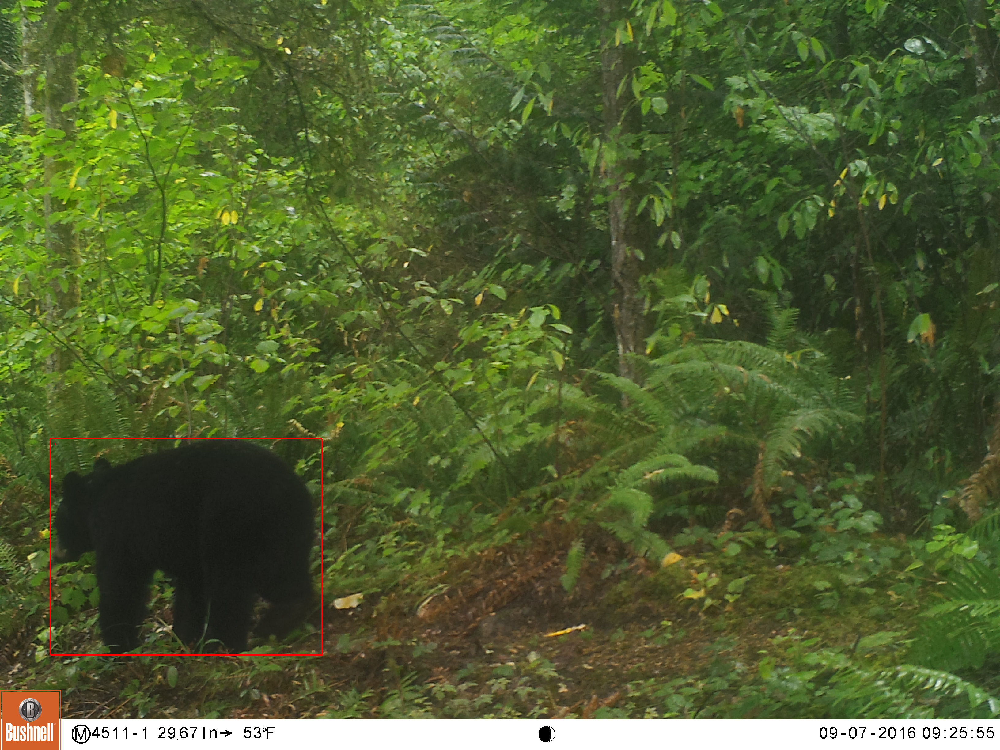

In [35]:
labeled_images[10]

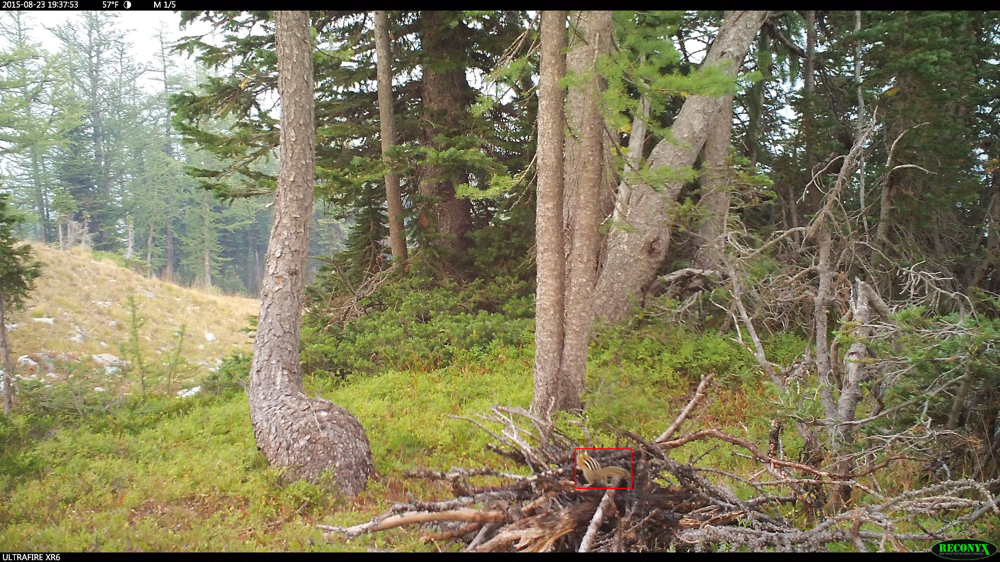

In [36]:
labeled_images[11]

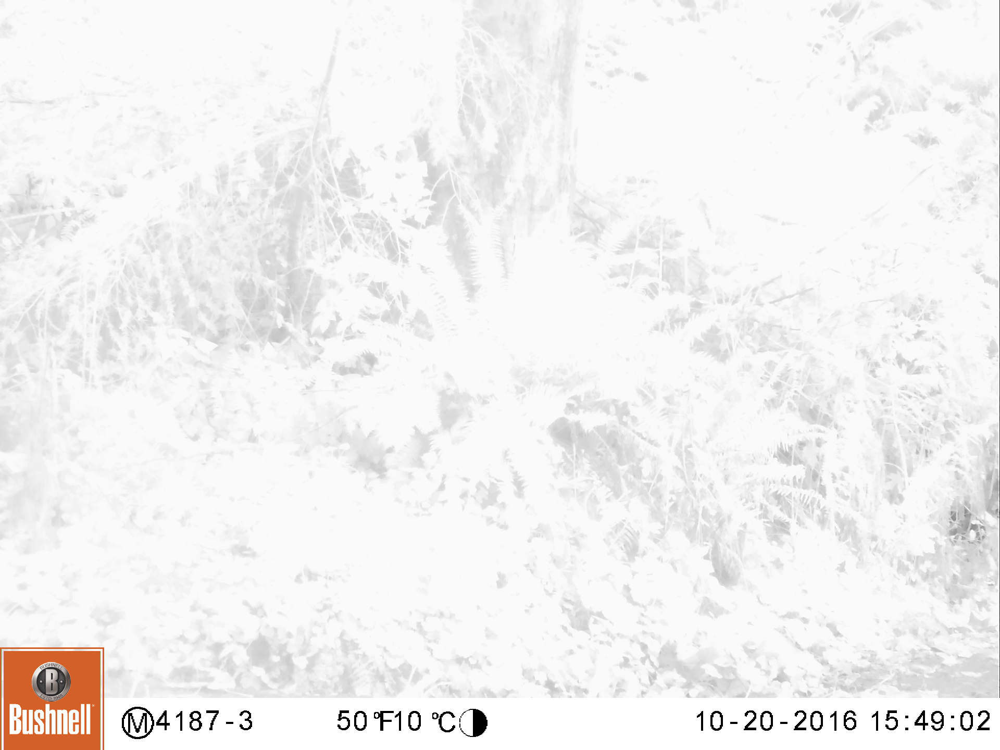

In [30]:
no_annotation_images[0]

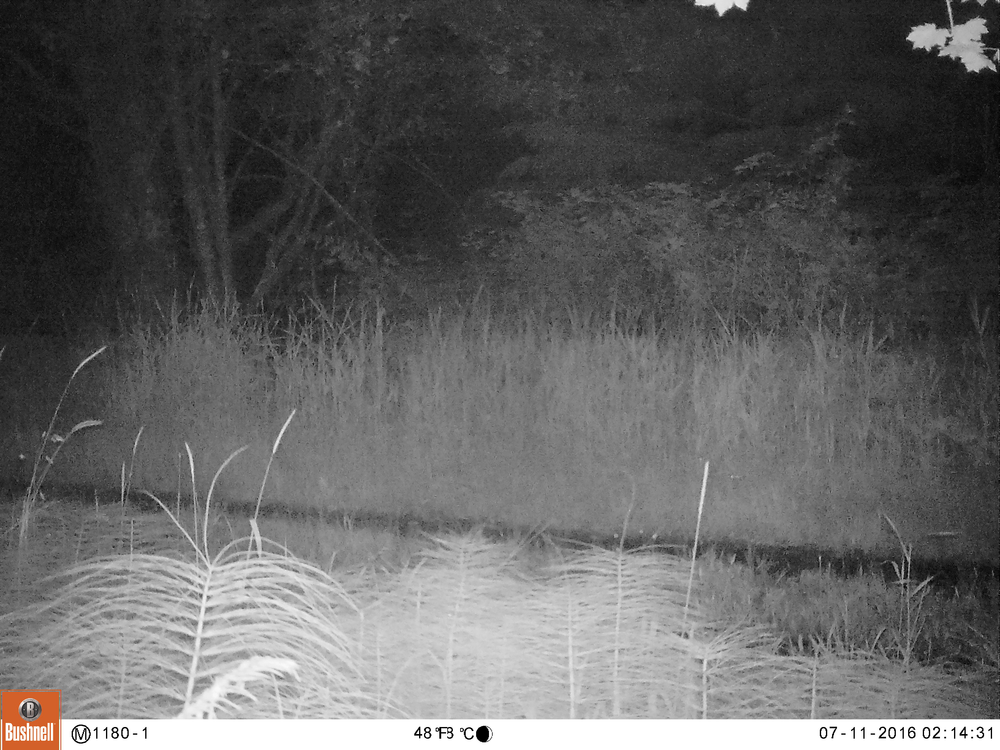

In [31]:
no_annotation_images[1]

### Visualize some images with persons

In [38]:
imgs_with_persons = df_anno[df_anno.human_visible == 1].image_id
len(imgs_with_persons)

0